[![Open in Colab](https://colab.research.google.com/assets/colab-badge.svg)](https://colab.research.google.com/github/KSpenko/gradientDescent/blob/master/1D/resonanca.ipynb)

In [7]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.integrate import solve_ivp
from scipy.optimize import golden, fmin_cg
from __animacija1D import animacija1D
from __metode import gradSpust, gradSpustMoment

** Optimizacija vsiljenega dušenega nihala **

V tem primeru bomo obravnavali nihanje dušenega nihala, ki ga vzbujamo z zunanjim periodičnim nihanjem ([https://en.wikipedia.org/wiki/Resonance](https://en.wikipedia.org/wiki/Resonance)). Nihanje je opisano z naslednjim diferencialnim enačbo:

$$\frac{d^2x}{dt^2} + 2\zeta \omega_0 \frac{dx}{dt} + \omega_0^2x = \frac{F_0}{m}\sin(\omega t)$$

kjer je $x$ lega nihala, $\omega_0$ lastna frekvenca, $\zeta$ dušenje, $F_0$ amplituda zunanjega nihanja in $\omega_0$ frekvenca zunanjega nihanja.

Pretvarjamo se, da ne poznamo vsiljenega nihanja, ki bo v našem primeru vsota večih sinusnih nihanj. Naša naloga je, da prilagajamo $\omega_0$ tako da bo amplituda nihanja čim manjša. Tega se bomo lotili na naslednji način:
- izberemo neko začetno vrednost $\omega_0$,
- rešimo diferencialno enačbo (glej [Runge-Kutta](https://en.wikipedia.org/wiki/Runge%E2%80%93Kutta_methods)), 
- po določenem času se nihanje ustali, zato pogledamo amplitudo nihanja, šele v drugi polovici časa simulacije nihanja,
- amplituda želimo maksimizirati, zato jo obravnavamo kot funkcijo katere ekstrem želimo poiskati z gradientnim spustom.

Na ta način želimo prisluškovati vsiljenemu nihanju in se z njim uglasiti.

In [8]:
class harmOscilator:
    """ Model za sumilacijo vzbujenega dušenega nihala: https://en.wikipedia.org/wiki/Resonance """
    def __init__(self, w0=10., sigma=0.1, m=1.):
        """ Parametri simulacije:
        w0    - lastna frekvenca nihala,
        sigma - razmerje dušenja,
        m     - masa nihala, """
        self.skalirniFaktor = -1500.
        self.w0 = w0
        self.sigma = sigma
        self.m = m
        self.freq = [13.,20.,31.]

    def ode(self, t, y):
        """ Sistem diferencialnih enačb """
        return np.array([y[1], self.extForce(t)/self.m - 2.*self.sigma*self.w0*y[1] - (self.w0**2.)*y[0]])

    def extForce(self, t):
        """ Zunanja sila vzbujanja """
        signal = np.sin(self.freq[0]*t)
        for i in range(1,len(self.freq)):
            signal += np.sin(self.freq[i]*t)
        return signal
    
    def f(self, x):
        """ Funkcija za minimizacijo, ki nam izračuna amplituda nihanja ob motnji. 
        Nihalo uglasimo na lastno frekvenco x in pogledamo kako dobro se odzove na zunanjo silo. """
        try: n = len(x)
        except Exception as e: x = [x]
        amp = []
        for w in x:
            self.w0 = w
            sol = solve_ivp(self.ode, [0, 20], [0., 0.], max_step=1e-2)
            # return np.mean(np.power(np.abs(sol.y[0,len(sol.y[0])//2:]),2.))
            amp.append( np.amax(sol.y[0,len(sol.y[0])*2//3:]) )
        if len(amp) == 1: amp = amp[0]
        return self.skalirniFaktor * np.array(amp)
    
    def samplePlot(self, w):
        """ Funkcija za priročno risanje grafov. """
        self.w0 = w
        sol = solve_ivp(self.ode, [0, 20], [0., 0.], max_step=1e-1)
        plt.figure()
        plt.plot(sol.t, self.skalirniFaktor*sol.y[0])
        plt.plot(sol.t, self.skalirniFaktor*np.abs(sol.y[0]))
        plt.show()

Najprej si oglejmo, kako izgleda simulirano nihanja, pri specifični vrednost lastne frekvence $\omega_0$.

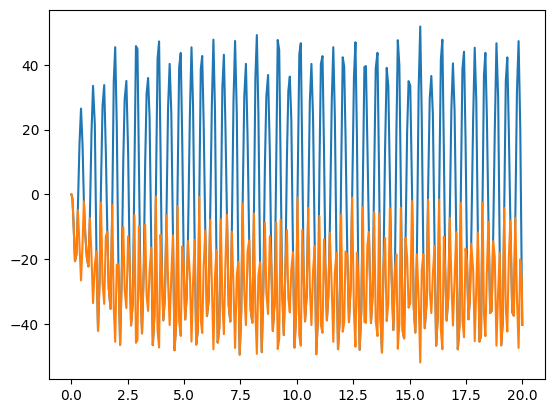

In [9]:
# Zagon simulacije
ho = harmOscilator()
ho.samplePlot(13)

Poglejmo si kako se odrežejo strokovne knjižnice.

In [10]:
# Metode iz strokovnih knjižnic
print(fmin_cg(ho.f, 15))
print(golden(ho.f, brack=[6, 35]))

Optimization terminated successfully.
         Current function value: -52.222557
         Iterations: 2
         Function evaluations: 28
         Gradient evaluations: 13
[12.83720118]


/var/folders/j4/92m7qhtn1w3ggvqrszlbmk300000gn/T/ipykernel_68419/2157568517.py:16: RuntimeWarning: invalid value encountered in double_scalars
  return np.array([y[1], self.extForce(t)/self.m - 2.*self.sigma*self.w0*y[1] - (self.w0**2.)*y[0]])
/Users/kristofspenko/Library/Python/3.9/lib/python/site-packages/scipy/optimize/_optimize.py:2884: RuntimeWarning: overflow encountered in double_scalars
  w = xb - ((xb - xc) * tmp2 - (xb - xa) * tmp1) / denom


-354.0850968475828


Sedaj pa narišimo funkcijo amplitude v odvisnosti od frekvence. To naredimo tako, da izračunamo amplitudo za vsako frekvenco posebej. Zraven pa si poglejmo se animacijo gradientnega spusta. Zopet se lahko igramo z začetno vrednostjo, ki jo ugibamo, ter z parametri gradientnega spusta.

19.910216310658548 -27.463923686435326 101


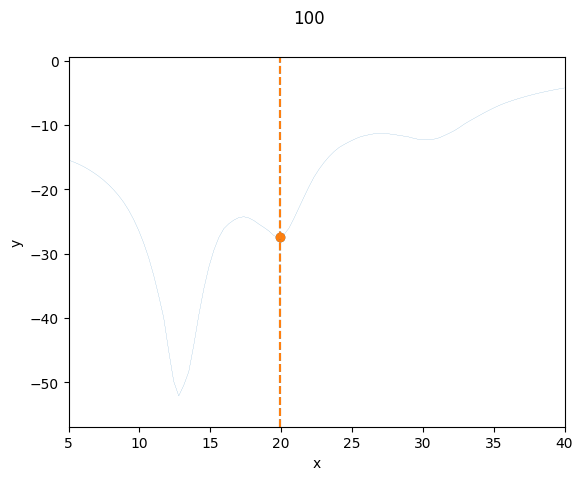

In [11]:
ani = animacija1D(ho.f, (5.,40.), fN=100)

# POZOR: Program je počasen!
# POSKUSI zagnati kakšno metodo več pod drugačnimi pogoji! (glej zakomentirane primere)
# Potek metod za par korakov-----------------------------------------------------------
ani.racunaj(metoda=gradSpust, x0=23., par=[0.1, 0.001], N=100)
# ani.racunaj(metoda=gradSpust, x0=7., par=[0.1, 0.001], N=100)
# ani.racunaj(metoda=gradSpustMoment, x0=23., par=[0.1, 0.001, 1.0, 0.2, -2.0], N=100)

ani.narisi(casAnimacije=500, verbose=0, save="resonanca", jupyter=True)

13.101157604260568 -50.76971485644092 1000


Animation size has reached 20987182 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


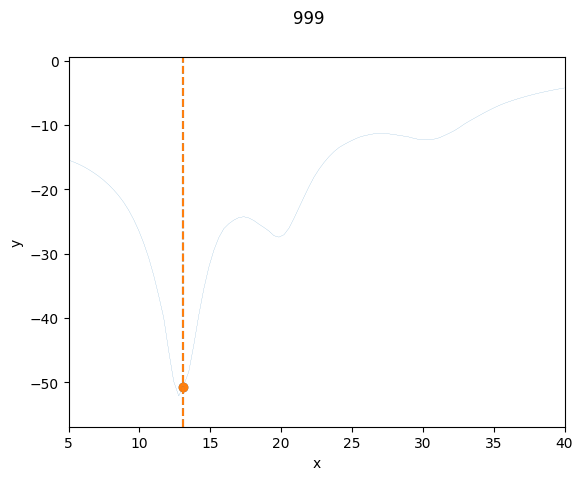

In [13]:
ani = animacija1D(ho.f, (5.,40.), fN=100)

# POZOR: Program je počasen!
# Potek metod do konvergence-----------------------------------------------------------
# ani.racunaj(metoda=gradSpust, x0=35., par=[0.01, 0.0001], eps=1e-5, konv=True)
ani.racunaj(metoda=gradSpustMoment, x0=23., par=[0.1, 0.001, 0.5, 0.2, -2.0], eps=1e-5, konv=True)

ani.narisi(casAnimacije=500, verbose=0, save="resonanca", jupyter=True)